# Milestone 3 example workflow: Monitoring forested areas


## Milestone 3

The main objective of this notebook is to demonstrate the recent updates applied to yt_Geotiff that enables polygon data selection (Milestone 3). The polygon data selection functionality builds on past developments, including window reads of raster datasets (Milestone 1) and the loading and up/down spatial resampling of raster datasets (.jpg and .tiff; Milestone 2). Specifically, the following updates to the yt_Geotiff extension:

- Loading of polygon shapefiles (including multi-feature polygons).
- Window reading and querying of multiband raster datasets based on polygon(s) coverage.
- Saving/exporting multiband window read datasets.

## Example workflow

The example scenario below involves querying multiband Landsat-8 imagery using a multi-polygon shapefile outlining forestry areas within Mabira National Park, Eastern Uganda. 

In [ ]:
import numpy as np
from pathlib import Path
import glob
import os
import matplotlib.pyplot as plt
import seaborn as sns

# yt packages
import yt
from yt.extensions.geotiff import save_as_geotiff

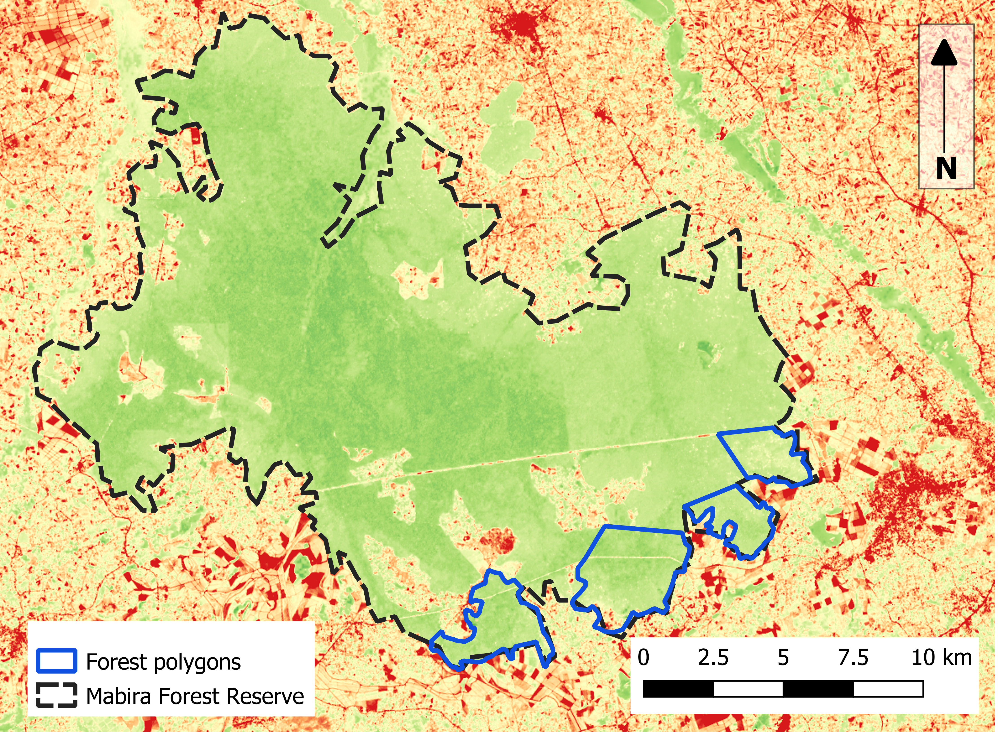

In [ ]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

### Search for Landsat 8 imagery in directory

In [ ]:
def file_list():
    directory= 'C:/Users/arevi/OneDrive/YT_GITHUB_v2/TEST_DATASETS/Landsat_test/'
    types = ('*.jp2', '*.TIF', '*.tiff') # the tuple of file types
    filenames = ""
    files_in_directory = []
    for files in types:
        files_in_directory.extend(glob.glob(directory+files)) # os.path.join
    return files_in_directory

In [ ]:
files_in_directory= file_list()
files_in_directory

### Load imagery in yt_Geotiff

In [ ]:
ds = yt.load(*files_in_directory)

In [ ]:
ds.field_list

Note, LS_B4 (visible red) is an alias to the highest-resolution Landsat Band 4 image available.

In [ ]:
ds.field_info['bands', 'LS_B4']

### Load a polygon shapefile

Load a multiple polygon shapefile.

In [ ]:
poly = ds.polygon(r"C:\Users\arevi\OneDrive\YT_GITHUB_v2\vector_sample\forest_multi_polygon_prj.shp")

### Plot the bounding rectangle

Let's first plot all the data in the rectangle containing the polygon.

Plot Landsat 8 Band 4.

In [ ]:
left_corner, right_corner = poly._get_bbox()
rectangle = ds.rectangle(left_corner, right_corner)

In [ ]:
p = ds.plot(('bands', 'LS_B4'), data_source=rectangle)
p.set_zlim(('bands', 'LS_B4'), 8000, 9000)
p.show()

### Plot polygon shapefile

Now, let's plot just the polygon of a spectral band.

In [ ]:
p = ds.plot(('bands', 'LS_B4'), data_source=poly)
p.set_zlim(('bands', 'LS_B4'), 8000, 9000)
p.show()

Plot the polygon of the NDVI derivable field

In [ ]:
# Define NDVI function 
def _ndvi(field, data):
    return (data[('bands', 'LS_B5_30m')] - data[('bands', 'LS_B4_30m')]) / \
           (data[('bands', 'LS_B5_30m')] + data[('bands', 'LS_B4_30m')])

In [ ]:
# Add NDVI to derivable fields list
ds.add_field(("band_ratios", "LS_NDVI"), function=_ndvi,
             units="", display_name='NDVI', take_log=False, sampling_type='local')

In [ ]:
# Plot polygons sample of NDVI
p = ds.plot(("band_ratios", "LS_NDVI"), data_source=poly)
p.set_zlim(("band_ratios", "LS_NDVI"), 0., 0.45)
p.set_cmap(("band_ratios", "LS_NDVI"), 'RdYlGn')

p.show()

Plot Landsat-8 temperature (Band 10; TIR)

In [ ]:
p = ds.plot(('variables','LS_temperature'), data_source=poly)
p.set_log(('variables', 'LS_temperature'), False)
p.set_zlim(('variables', 'LS_temperature'), 28, 35)
p.set_cmap(('variables', 'LS_temperature'), 'turbo')
p.set_unit(('variables', 'LS_temperature'), 'degC')
p.set_background_color(('variables', 'LS_temperature'), color='white')
p.show()

### Query data for the polygon

Data for all cells within or intersecting the polygon can be queried like all other data containers.

In [ ]:
print (f"Rectangle data: {rectangle['bands', 'LS_B4'].d}.")
print (f"Pixels in rectangle: {rectangle['bands', 'LS_B4'].size}.")
print (f"Polygon data: {poly['bands', 'LS_B4'].d}.")
print (f"Pixels in polygon: {poly['bands', 'LS_B4'].size}.")

Plot comparison between querying with the bounded area and the polygon area.

In [ ]:
fig1, (ax1) = plt.subplots(1,1, figsize=(14,6))
sns.set_theme(style="ticks")
sns.histplot(data=rectangle[('bands', 'LS_B4')], ax=ax1, color="r", label='Bounded area')
sns.histplot(data=poly[('bands', 'LS_B4')], ax=ax1, color="b", label='Polygon area')
ax1.set_xlabel('Landsat-8 Band-4 (visible red) reflectance')
ax1.set_xlim([8000, 10500])
ax1.legend()
plt.show()

### Output polygon query as table

Output polygon query as a table. 

In [ ]:
df = poly.to_dataframe(
    [('index', 'x'),
     ('index', 'y'),
     ('bands', 'LS_B4_30m'),
     ('bands', 'LS_B7_30m')])

In [ ]:
df

### Export polygon query to geotiff

Output polygon query as multiband geotiff.

In [ ]:
ds_fn, fm_fn = save_as_geotiff(ds, "multiband_dataset.tif", data_source=poly)

Load exported geotiff output back into yt_geotiff.

In [ ]:
ds_new = yt.load(ds_fn, field_map=fm_fn)

In [ ]:
ds.field_list

Plot exported geotiff output in yt_geotiff.

In [ ]:
q = ds_new.plot(('bands', 'LS_B5'))
q.set_zlim(('bands', 'LS_B5'), 13000, 25000)
q.show()

### Future developments

- Support virtual raster mosaics as yt datasets.
    - query data with geometric data containers spanning the mosaic
    - save data from container as single GeoTiff and reload
    - yt was designed around loading multi-resolution mesh data spanning multiple files (see below)
- Load multiple scenes from same band (e.g., time-series)
- Support commonly used NetCDF files.
- Interface with Sentinel-2 data on the Amazon Web Service.

### Minor enhancements:
- Add narrative documentation (i.e. sphinx-style) with expanded installation instructions examples
- Support polygons with different coordinate reference systems than base image.
- Use units of dataset's coordinate reference system (e.g., degrees lon/lat vs. meters)

![title](data0043_Slice_x_density.png)